## Instructions to run the notebook:

* If you are looking to experiment somemore or  run this locally or on google colab, please uncomment the code appropriately and run.

* If you are just looking to understand how to calculate data drift on text based data, please run the notebook as it is.

## Imports

In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [2]:
try:
    import evidently
except:
    !npm install -g yarn
    !pip install git+https://github.com/evidentlyai/evidently.git

In [3]:
from evidently.options.data_drift import DataDriftOptions
from evidently.test_suite import TestSuite
from evidently.tests import *

from evidently.dashboard import Dashboard
from evidently.dashboard.tabs import DataDriftTab

## Load cleaned Imdb movies review dataset (5000 rows) and amazon ecodot review dataset(2500 rows)

In [5]:
imdb_5k_data = pd.read_csv("./sample_data/cleaned_imdb_data_5000_rows.csv")

In [6]:
#amazon product review data of Gen3EcoDot 

eco_dot_data = pd.read_csv("./sample_data/echo_data.csv", squeeze= True)

## Load glove vectors

In [7]:
## Run this to experiment with the dataset with various ways of embedding (average over records / sum of records etc ...)
# !wget http://nlp.stanford.edu/data/glove.6B.zip
# !unzip glove.6B.zip

In [8]:
## Load glove vector from vector file
# def load_glove_model(File):
#   glove_model = {}
#   with open(File,'r') as f:
#       for line in f:
#           split_line = line.split()
#           word = split_line[0]
#           embedding = np.array(split_line[1:], dtype=np.float64)
#           glove_model[word] = embedding
#       return glove_model

In [9]:
## We load 50 dimension vector here
# glove_vec = load_glove_model("/content/glove.6B.50d.txt")
# glove_vec["apple"].shape

## Train test split the imdb dataset for input data drift comparison

In [10]:
## Perform train test split on imdb data

# train_df, test_df, y_train, y_test = train_test_split(imdb_5k_data.review, imdb_5k_data.sentiment, test_size=0.50, random_state=42)

In [11]:
# train_df.shape, test_df.shape

## Convert train and test records into embedding vectors

In [12]:
## Convert each record in Train set into a sentence vector by averaging the embeddings
# tr_arr = []
# for row in train_df.values:
#   tmp = np.zeros(50,)
#   for word in row:
#     try:
#       tmp += glove_vec[word]
#     except KeyError:
#       tmp+= np.zeros(50,)
#   tmp = tmp/len(row.split(" "))
#   tr_arr.append(tmp.tolist())

In [13]:
# train_df_converted = pd.DataFrame(np.array(tr_arr), index = train_df.index)
train_df_converted = pd.read_csv("https://raw.githubusercontent.com/SangamSwadiK/test_dataset/main/imdb_train_vectorized.csv")
train_df_converted.head()

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,-0.381491,3.842186,3.163375,3.268990,1.716181,-0.244856,1.811342,-3.424588,-1.184743,-0.061534,...,3.774490,0.275538,-0.955406,-0.215360,-0.306830,1.241856,0.867399,-1.963373,1.666094,4.384211
1,-0.364928,3.428283,2.872637,2.932077,1.422103,-0.258355,1.755376,-3.027312,-1.097868,-0.105749,...,3.441375,0.266090,-0.893476,-0.166002,-0.255953,1.197352,0.726796,-1.875431,1.364674,4.111564
2,-0.225922,3.184136,2.519968,2.971848,1.068490,-0.218869,1.504055,-2.913288,-0.902471,0.042850,...,3.329671,0.254596,-0.829084,-0.329340,-0.153338,0.862841,0.607194,-1.684554,1.477441,3.787845
3,-0.261043,3.496850,2.649218,2.948960,1.283928,-0.351531,1.672046,-2.960629,-1.044285,-0.051660,...,3.454432,0.194855,-0.792499,-0.328251,-0.305474,1.009205,0.686892,-1.852934,1.563900,3.740972
4,-0.371894,3.544178,3.041681,2.999930,1.551454,-0.209505,1.713554,-3.216542,-1.076544,-0.207425,...,3.562595,0.262266,-0.921348,-0.065731,-0.299506,1.192069,0.847945,-1.786974,1.450985,4.078656


In [14]:
## Convert each record in Test set into a sentence vector by averaging the embeddings
# te_arr = []
# for row in test_df.values:
#   tmp = np.zeros(50,)
#   for word in row:
#     try:
#       tmp += glove_vec[word]
#     except KeyError:
#       tmp+= np.zeros(50,)
#   tmp = tmp/len(row.split(" "))
#   te_arr.append(tmp.tolist())

In [15]:
# test_df_converted = pd.DataFrame(np.array(te_arr), index = test_df.index)
test_df_converted = pd.read_csv("https://raw.githubusercontent.com/SangamSwadiK/test_dataset/main/imdb_test_vectorized.csv")
test_df_converted.head()

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,-0.301892,3.456919,2.805822,2.952740,1.545965,-0.364327,1.792683,-2.878874,-1.229111,0.017821,...,3.368028,0.215296,-0.854739,-0.269794,-0.354434,1.066241,0.728645,-1.925135,1.520077,4.230904
1,-0.427536,3.647496,2.882300,3.151114,1.414213,-0.349614,1.707540,-3.145892,-1.009917,-0.073269,...,3.537440,0.263921,-0.778365,-0.232846,-0.286558,1.135535,0.738475,-1.965921,1.504252,4.090509
2,-0.322373,3.220931,2.661710,2.703467,1.460842,-0.336064,1.524281,-2.796387,-0.977345,-0.039393,...,3.239543,0.177134,-0.768166,-0.133148,-0.171684,1.097073,0.691741,-1.682584,1.445865,3.591712
3,-0.234422,3.295430,2.769252,2.916453,1.346506,-0.195492,1.554906,-2.946577,-1.006702,-0.067785,...,3.485205,0.271937,-0.748010,-0.253616,-0.213026,1.186579,0.736563,-1.736270,1.447214,3.903953
4,-0.298585,3.467689,2.833680,3.010032,1.445126,-0.295791,1.642785,-3.097794,-1.077196,0.023100,...,3.483806,0.254906,-0.836744,-0.211576,-0.345574,1.087492,0.762931,-1.854362,1.533544,4.021160


In [16]:
## Convert each record in Eco-Dot reviews  into a sentence vector by averaging the embeddings
# other_arr = []
# for row in eco_dot_data.values:
#   tmp = np.zeros(50,)
#   for word in row:
#     try:
#       tmp += glove_vec[word]
#     except KeyError:
#       tmp+= np.zeros(50,)
#   tmp = tmp/len(row.split(" "))
#   other_arr.append(tmp.tolist())

In [17]:
# ecodot_review_df_converted = pd.DataFrame(np.array(other_arr), index = eco_dot_data.index)
ecodot_review_df_converted = pd.read_csv("https://raw.githubusercontent.com/SangamSwadiK/test_dataset/main/eco_dot_review.csv")
ecodot_review_df_converted.head()

,0,1,2,3,4,5,6,7,8,9,...,40,41,42,43,44,45,46,47,48,49
0,0.327875,4.016490,2.791180,4.144133,1.833375,-0.312672,1.287727,-4.142395,-1.229878,1.161340,...,3.918637,-0.035790,-1.074380,-0.550616,-0.885010,0.599091,0.867318,-1.611072,3.009166,3.895240
1,-0.353587,4.744348,4.072236,4.225321,1.609850,-0.012264,2.406608,-4.641343,-1.675868,-0.039295,...,4.847699,0.667103,-1.344172,-0.314820,-0.918985,2.066251,1.230749,-2.030697,2.029354,5.928920
2,-0.436141,5.019880,3.867931,4.208932,1.866874,-0.683997,2.530752,-4.288440,-1.314428,0.170220,...,4.881951,0.363756,-0.983098,-0.482030,-0.655690,1.638361,1.098308,-2.558459,2.373431,4.871069
3,-0.520974,5.434466,3.984750,4.761608,1.522328,-0.786353,2.435981,-5.003207,-1.356486,0.155528,...,5.576414,0.392405,-0.879580,-0.363400,-0.971590,1.417375,1.163867,-2.981916,2.536001,5.487957
4,-0.445168,5.124225,3.961621,5.011146,1.692521,-0.773384,2.372935,-4.812509,-1.781645,0.553531,...,5.247725,0.419570,-1.119463,-0.591218,-0.662437,1.414253,0.961471,-2.823617,2.595306,5.771914


## Check Data Drift between train and test splits from IMDB movie review dataset

In [18]:
# Data Drift between imdb5k train and test 
options = DataDriftOptions(
  num_features_stattest ="wasserstein"
) 

data_drift = TestSuite(tests=[
   TestNumberOfDriftedColumns(options = options),
   TestShareOfDriftedColumns(options = options)
])


data_drift.run(
               reference_data = train_df_converted, 
               current_data = test_df_converted
               )
data_drift

In [19]:
#Data Drift dashboard between train and test split

imdb_data_drift_dashboard = Dashboard(tabs=[DataDriftTab(verbose_level=1)])

imdb_data_drift_dashboard.calculate(
                                     reference_data = train_df_converted, 
                                     current_data = test_df_converted
                                    )
imdb_data_drift_dashboard.show()

## Check Data drift between IMDB movie reviews and Eco-dot reviews dataset (train vs unseen dataset)

In [20]:
# Data Drift between imdb5k train Eco-dot

options = DataDriftOptions(
  num_features_stattest ="wasserstein"
) 

data_drift = TestSuite(tests=[
   TestNumberOfDriftedColumns(options = options),
   TestShareOfDriftedColumns(options = options)
])
 
data_drift.run(
               reference_data = train_df_converted, 
               current_data = ecodot_review_df_converted
               )
data_drift

In [21]:
#Data Drift dashboard between IMDB train and Eco-dot reviews

imdb_data_drift_dashboard = Dashboard(tabs=[DataDriftTab(verbose_level=1)])

imdb_data_drift_dashboard.calculate(
                                     reference_data = train_df_converted, 
                                     current_data = ecodot_review_df_converted
                                    )
imdb_data_drift_dashboard.show()

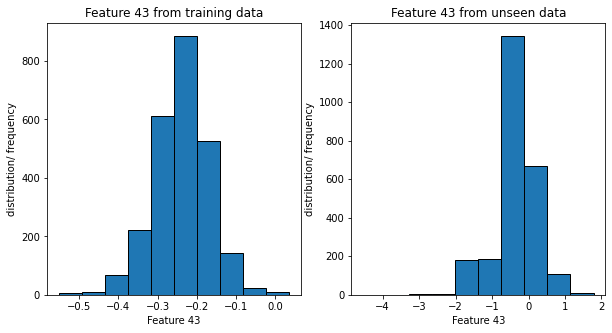

In [22]:
#Sample histogram plot for a drifted feature
f = plt.figure(figsize=(10,5))
ax1 = f.add_subplot(121)
ax2 = f.add_subplot(122)
ax1.hist(train_df_converted['43'].tolist(), edgecolor = 'k')
ax2.hist(ecodot_review_df_converted['43'].tolist(), edgecolor = 'k')
ax1.set_title("Feature 43 from training data")
ax2.set_title("Feature 43 from unseen data")
ax1.set_xlabel('Feature 43')
ax1.set_ylabel('distribution/ frequency')
ax2.set_xlabel('Feature 43')
ax2.set_ylabel('distribution/ frequency')
plt.show()